TODO: 
- Augment with 2D slices of higher dimensional manifolds
- Plot any intrinsic curves and surfaces

In [1]:
import sys
sys.path.append('../src')

In [2]:
from gso.core import PointCloud
from gso.manifolds import AlgebraicManifold
from gso.graph_sampling import GraphSampler
from gso.signal_generation import SignalGenerator
from gso.gso_learning import plot_attributed_graph

In [3]:
import networkx as nx
import time
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.sparse import csr_matrix
import csv
import sympy as sp

In [4]:
num_equations = 1
num_variables = 3
max_degree = 4
seed = 22

M = AlgebraicManifold(num_equations, num_variables, max_degree, seed)

In [5]:
def plot_algebraic_manifold(
    equations: list[sp.Expr],
    variables: list[sp.Symbol],
    points: PointCloud | None = None,
    padding: float = 2.0,
    resolution: int = 100,
    threshold: float = 1e-3,
    bounds: tuple[float, float] = (-5, 5)
):
    """
    Basic function plotting (continuous) manifolds in 2D and 3D ambiant space.
    Hence can take 
    - 2 variables with one function (curve)
    - 3 variables with one function (surface)
    - 3 variables with two functions (curve)
    """
    ambient_dim = len(variables)
    
    if ambient_dim == 2:
        import matplotlib.pyplot as plt
        import numpy as np
        from matplotlib.lines import Line2D

        # Create plot
        fig, ax = plt.subplots(figsize=(10, 8))
        legend_proxies = []

        # Determine grid bounds
        if points is None:
            x_min, x_max = bounds
            y_min, y_max = bounds
        else:
            x_min = points[:, 0].min() - padding
            x_max = points[:, 0].max() + padding
            y_min = points[:, 1].min() - padding
            y_max = points[:, 1].max() + padding

        # Create grid
        x = np.linspace(x_min, x_max, resolution)
        y = np.linspace(y_min, y_max, resolution)
        X, Y = np.meshgrid(x, y)

        # Plot each equation's contour
        for i, eq in enumerate(equations):
            func = sp.lambdify(variables, eq, 'numpy')
            try:
                Z = func(X, Y)
            except:
                Z = np.vectorize(lambda x,y: func(x,y))(X, Y)
            
            # Create contour with explicit solid line style
            contour = ax.contour(X, Y, Z, levels=[0], 
                               colors=[f'C{i}'], linewidths=2,
                               linestyles='-')  # Use standard dash pattern

            # Create proxy artist with guaranteed valid linestyle
            if len(contour.allsegs[0]) > 0:
                proxy = Line2D([0], [0], color=f'C{i}', 
                             linestyle='-',  # Force solid line style
                             linewidth=2)
                legend_proxies.append(proxy)

        # Add points if provided
        if points is not None:
            ax.scatter(points[:, 0], points[:, 1], c='red', s=30, 
                     label='Sampled Points')
            legend_proxies.append(Line2D([0], [0], marker='o', color='w',
                                      markerfacecolor='red', markersize=8))

        # Configure legend with validated entries
        labels = [f"Equation {i+1}" for i in range(len(equations))]
        if points is not None:
            labels.append("Sampled Points")
            
        ax.legend(legend_proxies, labels, loc='best')

        # Axis configuration
        ax.set_xlabel(str(variables[0]))
        ax.set_ylabel(str(variables[1]))
        ax.set_title("2D Algebraic Manifold")
        ax.set_aspect('equal')
        
        return fig
        
    elif ambient_dim == 3:
        import plotly.graph_objects as go
        import numpy as np
        
        # Symbolic to numeric conversion
        func = sp.lambdify(variables, equations[0], 'numpy')
        
        # Determine grid bounds using equation structure
        if points is None:
            x_min, x_max = bounds
            y_min, y_max = bounds
            z_min, z_max = bounds
        else:
            x_min, x_max = points[:, 0].min()-padding, points[:, 0].max()+padding
            y_min, y_max = points[:, 1].min()-padding, points[:, 1].max()+padding
            z_min, z_max = points[:, 2].min()-padding, points[:, 2].max()+padding

        # Create grid with adaptive resolution
        res = min(resolution, 50)  # Prevent memory overflow
        x, y, z = np.meshgrid(
            np.linspace(x_min, x_max, res),
            np.linspace(y_min, y_max, res),
            np.linspace(z_min, z_max, res),
            indexing='ij'
        )
        
        # Vectorized evaluation with NaN handling
        with np.errstate(all='ignore'):
            values = func(x, y, z)
            values = np.nan_to_num(values, nan=threshold*2)
        
        # Create isosurface plot
        fig = go.Figure(data=go.Isosurface(
            x=x.flatten(),
            y=y.flatten(),
            z=z.flatten(),
            value=values.flatten(),
            isomin=-threshold,
            isomax=threshold,
            surface_count=1,
            caps=dict(x_show=False, y_show=False, z_show=False),
            colorscale='Viridis',
            showscale=False
        ))
        
        # Add points if provided
        if points is not None:
            fig.add_trace(go.Scatter3d(
                x=points[:, 0],
                y=points[:, 1],
                z=points[:, 2],
                mode='markers',
                marker=dict(size=4, color='red')
            ))
        
        fig.update_layout(
            scene=dict(
                xaxis_title=str(variables[0]),
                yaxis_title=str(variables[1]),
                zaxis_title=str(variables[2]),
                aspectmode='cube'
            ),
            title=f"3D Manifold: {sp.pretty(equations[0], use_unicode=False)}"
        )
        return fig
    
    raise ValueError("Visualization only supports 2D or 3D ambient spaces")


## 2d surface in 3D space

In [6]:
num_equations = 1
num_variables = 3
max_degree = 4
seed = None
num_nodes = 20

M = AlgebraicManifold(num_equations, num_variables, max_degree, seed)
points = M.sample(num_nodes)

print(M.get_equations())
print(M.variables)
fig = plot_algebraic_manifold(M.get_equations(), M.variables, points=points)

[0.863364040973793*x0**3 + 0.984920227107333*x1 + 0.93262351416091*x2**3]
[x0, x1, x2]


In [7]:
fig.update_layout(
    scene=dict(
        xaxis=dict(
            title='',           # Remove axis label
            showticklabels=False,  # Remove tick values
            # showgrid=False,        # (Optional) Remove grid lines
            # zeroline=False         # (Optional) Remove axis line at zero
        ),
        yaxis=dict(
            title='',
            showticklabels=False,
            # showgrid=False,
            # zeroline=False
        ),
        zaxis=dict(
            title='',
            showticklabels=False,
            # showgrid=False,
            # zeroline=False
        ),
        aspectmode='cube'
    ),
    title=''
    # title=f"3D Manifold: {sp.pretty(equations[0], use_unicode=False)}"
)

In [8]:
fig.write_html("manifold_example01.html")
fig.write_image("example03_manifold.png", scale=10)  # 5x default resolution
# fig.write_image("manifold_example01.png", width=3000, height=2000)
# fig.write_image("manifold_example01.svg")
# fig.write_image("manifold_example01.pdf")

In [9]:
def visualize_matrix(matrix, n: int = 100, figsize = (5, 4), title = None, png_title=None, dpi=300) -> None:
    """
    Visualize weighted matrices as a square heatmap of size n by n.
        
    Args:
        n: Number of points to include in the visualization
    """
    n = min(n, matrix.shape[0])
    
    _, ax = plt.subplots(figsize=figsize)
    # sns.heatmap(matrix[:n, :n], square=True, annot=False, cmap='viridis', ax=ax)
    sns.heatmap(matrix[:n, :n], square=True, annot=False, cmap='jet', ax=ax)
    if title is not None:
        ax.set_title(title)
    if png_title:
        plt.savefig(f"{png_title}.png", dpi=dpi, bbox_inches="tight")
    plt.show()

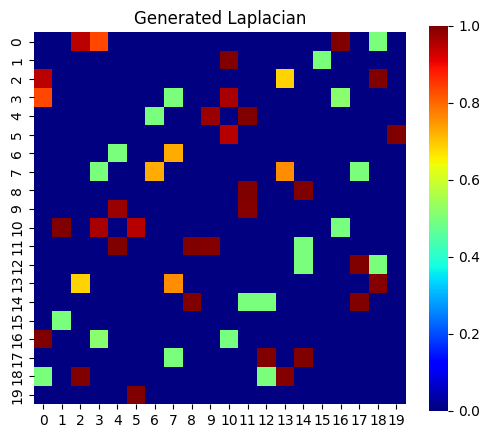

<Axes3D: >

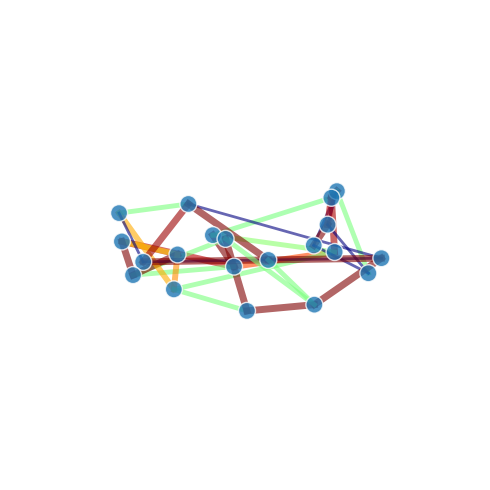

In [10]:
import numpy as np
from sklearn.neighbors import kneighbors_graph

# Knn structure
k = int(np.ceil(np.log(num_nodes)))  # mean degree ~ log(n)
X = np.random.rand(num_nodes, 2)
A = kneighbors_graph(X, k, mode='connectivity', include_self=False)

# Weights based on GraphSampler
L, W, point_cloud, epsilon = GraphSampler().create_weighted_graph_from_structure(M, A)
L_dense = L.toarray()
np.fill_diagonal(L_dense, 0)

# Visualize Laplacian
visualize_matrix(-L_dense, 99, title = "Generated Laplacian", png_title="example03_laplacian", dpi=500, figsize = (6, 5))

# Visualize graph
G = nx.Graph()
for i in range(num_nodes):
    for j in range(i+1, num_nodes):
        weight = -L_dense[i, j]
        if weight > 0:
            G.add_edge(i, j, weight=weight)

import matplotlib.cm as cm
plot_attributed_graph(G,
                      pos_color='grey', neg_color='grey', 
                      edge_alpha=0.6, node_size=150,
                      edge_attr='weight', k=5,
                      weight_as_width=True, 
                      edge_cmap=cm.jet,
                      min_edge_width=2, edge_scale=3,
                      fig_title="example03_graph", dpi=700, save_format="png")

## 1D curve in 3D space

In [63]:
num_equations = 2
num_variables = 3
max_degree = 4
seed = None

M = AlgebraicManifold(num_equations, num_variables, max_degree, seed)
points = M.sample(10000)

print(M.get_equations())
print(M.variables)
plot_algebraic_manifold(M.get_equations(), M.variables, points=points)

[-0.653785541483745*x0**3 + 0.833498715563081*x1**2 - 0.132538005899101*x2**3, -0.249517991031626*x0**3 + 0.0177334985578947*x1**3 + 0.344281625505617*x2**3]
[x0, x1, x2]


## 1D curve in 2D space

[0.478285444991916*x0**2 - 0.889570038333775*x1**2]
[x0, x1]


<function matplotlib.pyplot.show(close=None, block=None)>

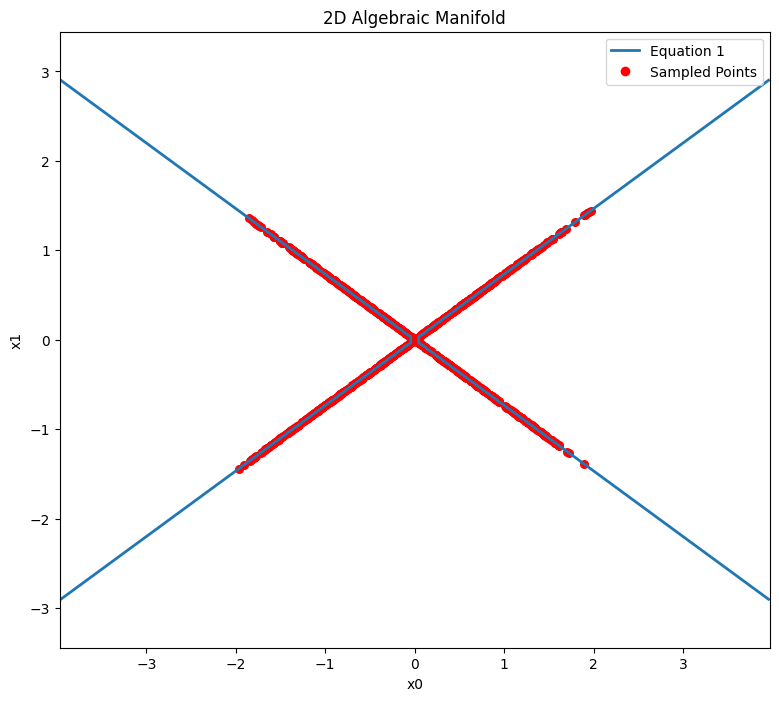

In [70]:
num_equations = 1
num_variables = 2
max_degree = 5
seed = None

M = AlgebraicManifold(num_equations, num_variables, max_degree, seed)
points = M.sample(10000)

print(M.get_equations())
print(M.variables)
plot_algebraic_manifold(M.get_equations(), M.variables, points=points)
plt.show